In [1]:
import os, sys, glob, re, math, pickle
import phate,scprep,magic,meld
import graphtools as gt
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import time,random,datetime
from sklearn import metrics
from sklearn import model_selection
from scipy import sparse
from scipy.stats import mannwhitneyu, tiecorrect, rankdata
from statsmodels.stats.multitest import multipletests
import scanpy as sc
import scvelo as scv
import warnings


sys.path.append('/home/ngr4/project/')
from scnd.scripts import data as scnddata
from scnd.scripts import utils as scndutils


In [2]:
scv.settings.figdir = '/home/ngr4/project/scnd/results/'

In [3]:
# load old
with open ('/home/ngr4/project/scnd/data/processed/hum_olopc_rnavel.h5ad', 'rb') as f:
    tdata = pickle.load(f)
    f.close()
    
tdata

AnnData object with n_obs × n_vars = 3573 × 28311
    obs: 'batch', 'Sample', 'genotype', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pmito', 'n_genes', 'doublet_score', 'predicted_doublet', 'leiden', 'source', 'ctype_v0', 'ctype_v1', 'ctype', 'sample_batch', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'root', 'end', 'velocity_pseudotime', 'latent_time', 'Sex'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s',

saving figure to file /home/ngr4/project/scnd/results/scvelo__20max.png


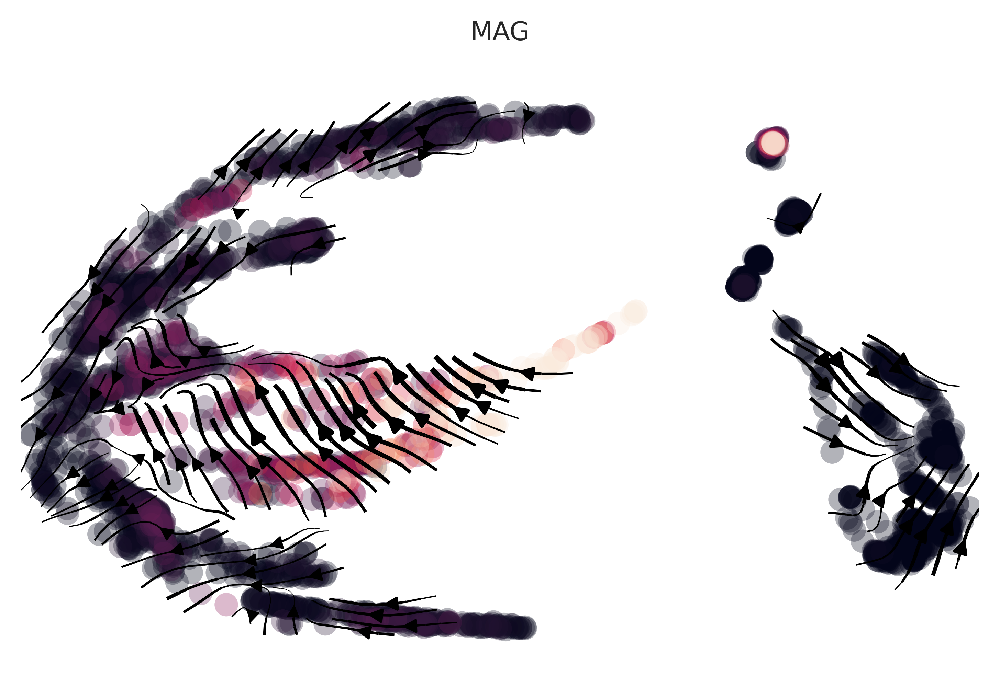

In [4]:
scv.pl.velocity_embedding_stream(tdata, basis='phate', color=['MAG',], 
                                 legend_loc='right_margin', ncols=3, vmax=20, save='_20max.png', dpi=600, colorbar=False)

saving figure to file /home/ngr4/project/scnd/results/scvelo__100max.png


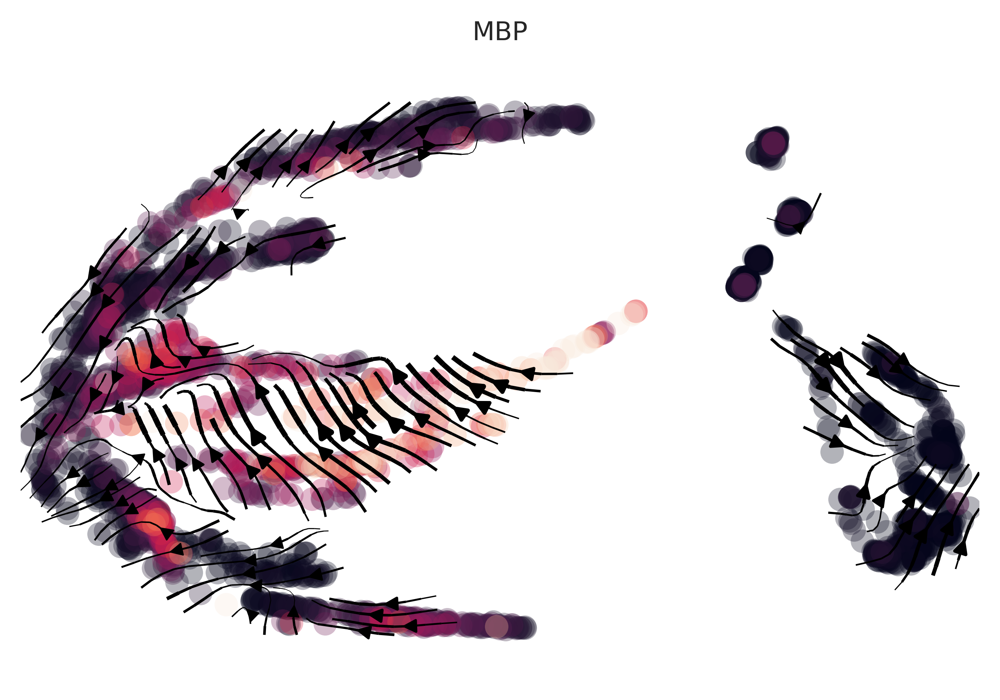

In [5]:
scv.pl.velocity_embedding_stream(tdata, basis='phate', color=['MBP',], 
                                 legend_loc='right_margin', ncols=3, vmax=100, save='_100max.png', dpi=600, colorbar=False)

In [6]:
scv.pl.velocity_embedding_stream(tdata, basis='phate', color=['ctype','genotype', 'MBP','MAG', 'PDGFRA', 'latent_time', 'batch', 'Sex'], 
                                 legend_loc='right_margin', ncols=1, save='_withsex.png', dpi=600, colorbar=False)

saving figure to file /home/ngr4/project/scnd/results/scvelo__withsex.png


In [7]:
# split by genotype 
wt = tdata[tdata.obs['genotype']=='CTRL', :].copy()
sca1 = tdata[tdata.obs['genotype']=='SCA1', :].copy()

In [16]:
scv.pl.velocity_embedding_stream(wt, basis='phate', color=['latent_time',], 
                                 legend_loc='right_margin', ncols=1, save='_wt.png', dpi=600, color_map='viridis_r', colorbar=False)
scv.pl.velocity_embedding_stream(sca1, basis='phate', color=['ctype','genotype', 'MBP','MAG', 'PDGFRA', 'latent_time',], 
                                 legend_loc='right_margin', ncols=1, save='_sca1.png', dpi=600, color_map='viridis_r', colorbar=False)

saving figure to file /home/ngr4/project/scnd/results/scvelo__wt.png


saving figure to file /home/ngr4/project/scnd/results/scvelo__sca1.png


In [9]:
scv.tl.rank_velocity_genes(wt)
df = scv.DataFrame(wt.uns['rank_velocity_genes']['names'])
df.head()

computing velocity clusters
    finished (0:00:02) --> added 
    'velocity_clusters', clusters based on louvain modularity on velocity vector field (adata.obs)
ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,BRINP3,IGSF9B,OPCML,ATP8A2,RBFOX3,ZNF385D,RBFOX3,AKAIN1,FSTL5,GRM3,PALM2-AKAP2,HHIP,JPH1,MAN2A1,CCDC175,CADPS2,SORCS2,ELL2,AKAP12,SERF2
1,PCDH7,TMEM132C,UST,KIAA0513,RELN,PRAG1,GPRIN3,NYAP2,PCLO,PCDH9,SIK3,IQGAP1,PLEKHG1,AL162511.1,WSCD2,EPHA6,DICER1,PHLDB1,FXR1,SELENOW
2,SNTG1,SEMA5A,MEGF11,SPTB,SLIT3,STXBP5L,SPTB,PLCXD3,COL19A1,SPOCK3,CREB5,AGPAT4,ABCA6,ACTN2,TENM1,SELENOW,LANCL1,DICER1,PTGDS,S100A1
3,LUZP2,SHISA9,SLC1A2,FRY,TMEM51-AS1,ABLIM1,CALN1,GABRB2,SYNE1,PEX5L,CDK19,TTLL7,LUCAT1,QKI,RUNX1T1,ARHGAP29,RASGRF2,CNDP1,AMD1,DTNB
4,NXPH1,CSMD2,NTRK3,CAMK1D,SH3GL2,RAB37,SV2B,KCNJ3,RALYL,PIEZO2,KCNK10,CTNNA3,CPEB2,LUCAT1,GRM1,OLFM3,FMNL2,NEK3,GRIA2,LDB3


In [10]:
top_genes_wt = wt.var['fit_likelihood'].sort_values(ascending=False).index[:100]

saving figure to file /home/ngr4/project/scnd/results/scvelo_heatmap__wt.pdf


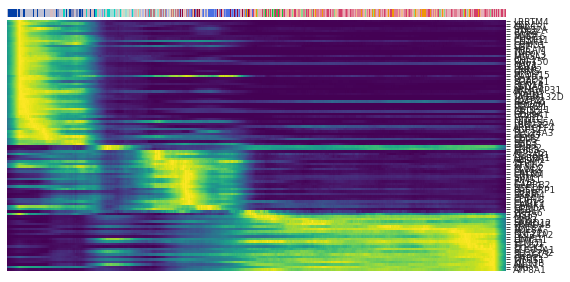

In [11]:
scv.pl.heatmap(wt, var_names=top_genes_wt, sortby='latent_time', n_convolve=100,
#                layer='imputed',
               col_color='velocity_clusters',
               colorbar=True,
#             color_map='viridis_r',
               yticklabels=True,
               save='_wt.pdf',
              )

computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on louvain modularity on velocity vector field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
saving figure to file /home/ngr4/project/scnd/results/scvelo_heatmap__sca1.pdf


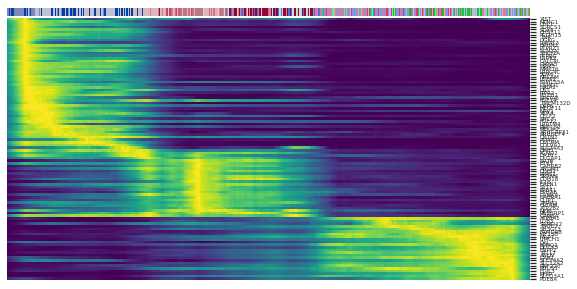

In [12]:
scv.tl.rank_velocity_genes(sca1)
top_genes_sca1 = sca1.var['fit_likelihood'].sort_values(ascending=False).index[:100]
scv.pl.heatmap(sca1, var_names=top_genes_sca1, sortby='latent_time', 
               col_color='velocity_clusters',
               n_convolve=100,
#                layer='imputed',
               colorbar=True,
#                            color_map='viridis_r',
               yticklabels=True,
               font_scale=0.5,
               save='_sca1.pdf',
              )

In [13]:
fname = '/home/ngr4/project/scnd/results/hum_redo_dyngenes_top100_wt.csv'
pd.DataFrame(np.asarray(wt[:, top_genes_wt].X.todense()), index=wt.obs.index.to_list(), columns=top_genes_wt).to_csv(fname)

In [14]:
fname = '/home/ngr4/project/scnd/results/hum_redo_dyngenes_top100_sca1.csv'
pd.DataFrame(np.asarray(sca1[:, top_genes_sca1].X.todense()), index=sca1.obs.index.to_list(), columns=top_genes_sca1).to_csv(fname)